In [ ]:

# eye analysis within a trial 
# save: fixation duration, saccadic amplitude, and number of fixations.
# eye event output comparison

In [15]:
#read data

import glob
import pandas as pd

paths = ['C:/Users/ZHT/Documents/dataProcess/Pon_behaviorC',
    'C:/Users/ZHT/Documents/dataProcess/ponEyes',
    'C:/Users/ZHT/Documents/dataProcess/ponFrame'
]
icon = 'Jia'
data=[1,1,1]

for i,path in enumerate(paths):
    file  = glob.glob(path + f'/{icon}*.json')
    print(file)
    data[i] = pd.read_json(file[0])



['C:/Users/ZHT/Documents/dataProcess/Pon_behaviorC\\Jia-08-26-10-00-55-2024.json']
['C:/Users/ZHT/Documents/dataProcess/ponEyes\\Jia-08-26-10-00-47-2024.json']
['C:/Users/ZHT/Documents/dataProcess/ponFrame\\Jia-08-26-10-00-55-2024.json']


144793
56523


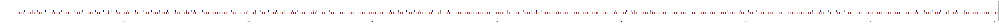

In [14]:
# 3 lists 
eyet = data[1]['SystemTimeStamp']
frameTime = data[2]['timeStamp']
frameTag = data[2]['frameTag']
#convert frame time
import datetime
import numpy as np 

frameTime = frameTime.astype(np.int64)/1000000
frameTime = frameTime.round(0).astype(np.int64)


print(len(eyet))
print(len(frameTime))
# event plot timestamp
import matplotlib.pyplot as plt 
import mpld3
mpld3.enable_notebook()

fig, ax = plt.subplots(1,1, figsize=(200, 4))
plt.xlim(min(frameTime),(max(frameTime)-min(frameTime))/100+min(frameTime))
plt.ylim(0,1)
plt.eventplot(frameTime,lineoffsets=0.5,linelengths=0.1,colors='b')
plt.eventplot(eyet,linelengths=0.1,colors='r', lineoffsets=0.4)


In [16]:

# trial segmentation
frameTime = frameTime.to_frame()
frameTime['deltaframe'] = frameTime.diff()
frameTime
#frameTime.loc[frameTime['deltaframe'] >800]

,timeStamp,deltaframe
0,1724636034048,NaN
1,1724636034085,37.0
2,1724636034112,27.0
3,1724636034138,26.0
4,1724636034164,26.0
...,...,...
56518,1724637635629,29.0
56519,1724637635659,30.0
56520,1724637635687,28.0
56521,1724637635716,29.0


In [18]:
#frameTime['deltaframe'].unique()
tag = frameTime.loc[frameTime['deltaframe']>800 ]
tag.index

Index([  238,   311,   379,   437,   502,   569,   635,   711,   791,   865,
       ...
       55998, 56050, 56119, 56169, 56225, 56273, 56339, 56391, 56445, 56498],
      dtype='int64', length=833)

In [44]:
data[2]

,frameTag,targetpos,targetpos2,ponPos,timeStamp
0,0,"[{'X': 362.607025, 'Y': -11.5885592}, {'X': 25...","[{'X': 503.000671, 'Y': -9.822872}, {'X': 397....","[{'X': 1534.42358, 'Y': -184.962921}, {'X': 15...",2024-08-26 01:33:54.048
1,1,"[{'X': 920.9497, 'Y': 359.273071}, {'X': 973.1...","[{'X': 848.86145, 'Y': 335.2118}, {'X': 909.91...","[{'X': 784.6636, 'Y': 421.640442}, {'X': 848.3...",2024-08-26 01:33:54.085
2,2,"[{'X': 920.9497, 'Y': 359.273071}, {'X': 973.1...","[{'X': 848.86145, 'Y': 335.2118}, {'X': 909.91...","[{'X': 784.6636, 'Y': 421.640442}, {'X': 848.3...",2024-08-26 01:33:54.112
3,3,"[{'X': 920.9497, 'Y': 359.273071}, {'X': 973.1...","[{'X': 848.86145, 'Y': 335.2118}, {'X': 909.91...","[{'X': 784.6636, 'Y': 421.640442}, {'X': 848.3...",2024-08-26 01:33:54.138
4,4,"[{'X': 920.9497, 'Y': 359.273071}, {'X': 973.1...","[{'X': 848.86145, 'Y': 335.2118}, {'X': 909.91...","[{'X': 784.6636, 'Y': 421.640442}, {'X': 848.3...",2024-08-26 01:33:54.164
...,...,...,...,...,...
56518,19,"[{'X': 977.7642, 'Y': 362.50665300000003}, {'X...","[{'X': 838.9356, 'Y': 361.771729}, {'X': 938.8...","[{'X': 1391.87756, 'Y': 736.5634}, {'X': 1421....",2024-08-26 02:00:35.629
56519,20,"[{'X': 977.7642, 'Y': 362.50665300000003}, {'X...","[{'X': 838.9356, 'Y': 361.771729}, {'X': 938.8...","[{'X': 1391.87756, 'Y': 736.5634}, {'X': 1421....",2024-08-26 02:00:35.659
56520,21,"[{'X': 977.7642, 'Y': 362.50665300000003}, {'X...","[{'X': 838.9356, 'Y': 361.771729}, {'X': 938.8...","[{'X': 1391.87756, 'Y': 736.5634}, {'X': 1421....",2024-08-26 02:00:35.687
56521,22,"[{'X': 977.7642, 'Y': 362.50665300000003}, {'X...","[{'X': 838.9356, 'Y': 361.771729}, {'X': 938.8...","[{'X': 1391.87756, 'Y': 736.5634}, {'X': 1421....",2024-08-26 02:00:35.716


In [43]:
data[1]

,LeftGazeX,LeftGazeY,RightGazeX,RightGazeY,LeftPupilSize,RightPupilSize,SystemTimeStamp,TrailTag,FrameTag,isGrey,Validity
0,0.507018,0.473126,0.524312,0.475640,2.369843,2.276108,1724636034297,0,10,False,"Valid,Valid,Valid,Valid"
1,0.505640,0.476988,0.525022,0.474818,2.376907,2.270599,1724636034307,0,10,False,"Valid,Valid,Valid,Valid"
2,0.506562,0.475779,0.524353,0.475748,2.370285,2.271484,1724636034318,0,10,False,"Valid,Valid,Valid,Valid"
3,0.502535,0.482563,0.520137,0.477998,2.368332,2.259811,1724636034329,0,11,False,"Valid,Valid,Valid,Valid"
4,0.489848,0.482457,0.509874,0.487053,2.374054,2.265182,1724636034340,0,11,False,"Valid,Valid,Valid,Valid"
...,...,...,...,...,...,...,...,...,...,...,...
144788,0.588320,0.992276,0.580658,0.985580,3.190750,2.953201,1724637643611,833,0,True,"Valid,Valid,Valid,Valid"
144789,0.587602,0.991341,0.581687,0.981019,3.194580,2.961380,1724637643622,833,0,True,"Valid,Valid,Valid,Valid"
144790,0.585110,0.992794,0.581903,0.980961,3.193909,2.955032,1724637643633,833,0,True,"Valid,Valid,Valid,Valid"
144791,0.589965,0.995823,0.582584,0.976645,3.173386,2.944077,1724637643644,833,0,True,"Valid,Valid,Valid,Valid"
